# Housekeeping

Print instance stats.

In [ ]:
# !ln -sf /opt/bin/nvidia-smi /usr/bin/nvidia-smi
# !pip install gputil
# !pip install psutil
# !pip install humanize


In [ ]:
import psutil
import humanize
import os
import GPUtil as GPU
GPUs = GPU.getGPUs()

In [ ]:
gpu = GPUs[0]
def printm():
    process = psutil.Process(os.getpid())
    print("Gen RAM Free: " + humanize.naturalsize( psutil.virtual_memory().available ), " | Proc size: " + humanize.naturalsize( process.memory_info().rss))
    print("GPU RAM Free: {0:.0f}MB | Used: {1:.0f}MB | Util {2:3.0f}% | Total {3:.0f}MB".format(gpu.memoryFree, gpu.memoryUsed, gpu.memoryUtil*100, gpu.memoryTotal))
printm()

Gen RAM Free: 53.8 GB  | Proc size: 179.5 MB
GPU RAM Free: 16130MB | Used: 0MB | Util   0% | Total 16130MB


First, install and import everything we need to use to implement and visualise the network.

In [ ]:
#!wget https://archive.org/download/documerica/documerica.tar.gz

In [ ]:
#!wget https://archive.org/download/documerica/dustified_64.tar.gz

In [ ]:
#!tar -xvzf documerica.tar.gz -C '/content/drive/My Drive/documerica/'

In [ ]:
#!tar -xvzf dustified_64.tar.gz -C '/content/drive/My Drive/documerica/documerica/'

In [ ]:
#!pip install wandb

In [ ]:
import fastai
import wandb
from wandb.fastai import WandbCallback
from fastai.vision import *
from fastai.callbacks import *
from fastai.callbacks.hooks import *
from fastai.vision.gan import *
from functools import partial
import matplotlib.pyplot as plt
from skimage import io, color, exposure
import numpy as np
import scipy.ndimage
import cv2
from matplotlib import cm
import pytorch_ssim
from torchvision.models import resnet34, vgg16_bn

%matplotlib inline

In [ ]:
torch.manual_seed(420)
torch.cuda.manual_seed_all(420)
np.random.seed(420)
dtype = torch.float

Make sure we use the GPU provided by Colab.

In [ ]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
device

device(type='cuda', index=0)

We can add a `project_id` and an `experiment_id` to use when logging results.

In [ ]:
project_id = 'ScratchRemovalFeatureLoss3'
experiment_id = project_id+'-2'

# Preparing the dataset
The dataset used in this was created by scraping slide scans from Flickr which had no copyright restrictions imposed on them. The photos are part od the Documerica series. I've downsized them, then cropped non-overlappng 512 by 512 squares. The corrupted examples have been created by synthetically adding dust and scratches using free film overlays I found online.

Create the path variables we are going to be using to load the dataset and record model progress on Google Drive. Since we will be progressively resizing the input, we're going to use three different versions of the `dustified` and `clean` classes - images which are 64px, 128px, 256px and 512px squares. Each different size of the same image will have the same file name so we can match them with the clean class. Each of them has different pseudorandom synthetic film noise applied.

In [ ]:
path = '/home/jupyter/documerica'
path_hr = path+'/dataset/clean'
path_hr_256 = path+'/dataset/clean_256'
path_hr_128 = path+'/dataset/clean_128'
path_hr_64 = path+'/dataset/clean_64'
path_lr = path+'/dataset/dustified_512'
path_lr_256 = path+'/dataset/dustified_256'
path_lr_128 = path+'/dataset/dustified_128'
path_lr_64 = path+'/dataset/dustified_64'

In [ ]:
il = ImageList.from_folder(path_hr)
il

ImageList (6232 items)
Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512)
Path: /home/jupyter/documerica/dataset/clean

In [ ]:
# def resize_one(fn, i, path, size):
#     dest = path/fn.relative_to(path_hr)
#     dest.parent.mkdir(parents=True, exist_ok=True)
#     img = PIL.Image.open(fn)
#     targ_sz = resize_to(img, size, use_min=True)
#     img = img.resize(targ_sz, resample=PIL.Image.ANTIALIAS).convert('RGB')
#     img.save(dest, quality=100)

# # create smaller image sets the first time this nb is run
# sets = [(path_hr_256, 256), (path_hr_128, 128), (path_hr_64, 64)]
# for p,size in sets:
#     if not os.path.exists(p):
#         print(f"resizing to {size} into {p}")
#         parallel(partial(resize_one, path=p, size=size), il.items)

First we use the standard fast.ai transforms, including 

*   Random crop (w/ padding)
*   Symmetric warp
*   Random rotation
*   Zoom
*   Brightness variation
*   Contrast variation



In [ ]:
tfms_gen = get_transforms(max_zoom=1.5, max_lighting=0.5, max_warp=0.25)
tfms_gen

([RandTransform(tfm=TfmCrop (crop_pad), kwargs={'row_pct': (0, 1), 'col_pct': (0, 1), 'padding_mode': 'reflection'}, p=1.0, resolved={}, do_run=True, is_random=True, use_on_y=True),
  RandTransform(tfm=TfmPixel (flip_lr), kwargs={}, p=0.5, resolved={}, do_run=True, is_random=True, use_on_y=True),
  RandTransform(tfm=TfmCoord (symmetric_warp), kwargs={'magnitude': (-0.25, 0.25)}, p=0.75, resolved={}, do_run=True, is_random=True, use_on_y=True),
  RandTransform(tfm=TfmAffine (rotate), kwargs={'degrees': (-10.0, 10.0)}, p=0.75, resolved={}, do_run=True, is_random=True, use_on_y=True),
  RandTransform(tfm=TfmAffine (zoom), kwargs={'scale': (1.0, 1.5), 'row_pct': (0, 1), 'col_pct': (0, 1)}, p=0.75, resolved={}, do_run=True, is_random=True, use_on_y=True),
  RandTransform(tfm=TfmLighting (brightness), kwargs={'change': (0.25, 0.75)}, p=0.75, resolved={}, do_run=True, is_random=True, use_on_y=True),
  RandTransform(tfm=TfmLighting (contrast), kwargs={'scale': (0.5, 2.0)}, p=0.75, resolved={},

We create a `DataBunch` using the dustified images. It wraps an `ImageImageList` maps corresponding image pairs from each of the two classes (clean and dusty). In order to split the dataset into training/validation/test using 80/10/10 ratio, we will randomly split the indeces of a dataframe where each index corresponds to an image pair filename. 

First step is to collect image filenames in a dataframe. Filename for the each clean and dusty example from a given pair is the same (they are just in a different subfolder, `clean` or `dustified`.

In [ ]:
data_images = []
for file in sorted(os.listdir(path_hr)):
    if file[-4:] == '.png': data_images.append(file)

df_images = pd.DataFrame(data_images, columns=['Filename'])
df_images

,Filename
0,"tile_resize_""alaska-cotton""-found-in-397119356..."
1,"tile_resize_""big-muskie,""-owned-by-th376988340..."
2,"tile_resize_""bing-the-king""--""have-or401144519..."
3,"tile_resize_""broken-fireplace"",-older401236238..."
4,"tile_resize_""cat-skinners""-at-work-in700701922..."
...,...
6227,tile_resize_youngsters-wrestle-with-a390645229...
6228,tile_resize_youths-congregate-around-472692767...
6229,"tile_resize_yucca,-05-19723856282239.jpg.png"
6230,"tile_resize_yucca,-05-19723856286507.jpg.png"


We will then split the resulting dataframe into 3 sub-dataframes for taining, testing and validation using `np.split`. Split ratio of 80/10/10 is used. The important thing is to have a random selection of indeces for each subset.

In order to make the experiments reproducible, we will save the random split subsets as .csv files, so that the exact same split can be used between multiple sessions. **If a new split is required, this code can be run again, but in general, this cell only needs to be run once.**

In [ ]:
#train, validate, test = np.split(df_images.sample(random_state=np.random.RandomState(42), frac=1), [int(.8*len(df_images)), int(.9*len(df_images))])

We can double-check the split is correct and that random indeces are selected for each subset. We can also see that the training set is 80% of the original data set, and the testing and validation ones are 10% each respectively.

Save the data frames as .csv files. **Only do this on the first run, when the initial data frame is first split.**

In [ ]:
# os.mkdir(path+'/split/')
# train.to_csv(path+'/split/train.csv')
# test.to_csv(path+'/split/test.csv')
# validate.to_csv(path+'/split/validate.csv')

This will load `.csv` files which contain the split we used for all experiments.

In [ ]:
train = pd.read_csv(path+'/split/train.csv', index_col=0)
test = pd.read_csv(path+'/split/test.csv', index_col=0)
validate = pd.read_csv(path+'/split/validate.csv', index_col=0)

In [ ]:
train

,Filename
5077,tile_resize_sunbathing-at-south-beach472757044...
2410,tile_resize_garfield-county-fair.-jud381584515...
3520,tile_resize_more-than-40-species-of-l472691430...
230,tile_resize_a-nurse-helps-an-elderly-765125420...
378,tile_resize_abandoned-house-and-ruste401158252...
...,...
5636,tile_resize_tourists-just-off-buses-c715794829...
1279,tile_resize_chugach-peaks-south-of-th397130800...
6108,tile_resize_window-glass-detail-of-a-401147311...
1555,tile_resize_coral-and-marine-life-at-472690686...


In [ ]:
validate

,Filename
3190,tile_resize_looking-across-the-andros375234825...
4566,tile_resize_rustic-station-at-east-gl715839660...
4802,"tile_resize_sipapu-bridge,-white-cany706559039..."
5841,tile_resize_veterans'-cemetery4268347359.jpg.png
4841,tile_resize_small-playground-at-runwa368240882...
...,...
2681,tile_resize_homemade-bread-and-sweet-472688051...
2993,"tile_resize_kosciosko-swimming-pool,-388752412..."
5512,"tile_resize_thirty-days-after-fire,-i700697883..."
1191,tile_resize_caribou-graze-near-the-sa397119208...


In [ ]:
test

,Filename
1542,tile_resize_convent-for-sisters-of-ch472690934...
3301,tile_resize_man-operating-a-continuou390641487...
3324,tile_resize_marina-on-the-potomac-in-746137543...
2539,tile_resize_hand-carved-front-doors-o401148275...
953,tile_resize_black-beauties-complement867594965...
...,...
3772,tile_resize_oil-wells-near-teapot-dom691981385...
5191,"tile_resize_the-""silver-spade""-shovel376910550..."
5226,tile_resize_the-calcasieu-paper-mill-370356437...
5390,tile_resize_the-owners-of-this-farm-s376987901...


Now we can pass the indeces for training and validation to create the fast.ai `ImageImageList` which will hold the data during training.

In [ ]:
src = ImageImageList.from_df(df=df_images, path=path_lr, cols=['Filename']).split_by_idxs(train_idx=train.index.to_list(), valid_idx=validate.index.to_list())
src

ItemLists;

Train: ImageImageList (4985 items)
Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512)
Path: /home/jupyter/documerica/dataset/dustified_512;

Valid: ImageImageList (623 items)
Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512)
Path: /home/jupyter/documerica/dataset/dustified_512;

Test: None

In [ ]:
src_256 = ImageImageList.from_df(df=df_images, path=path_lr_256, cols=['Filename']).split_by_idxs(train_idx=train.index.to_list(), valid_idx=validate.index.to_list())
src_256

ItemLists;

Train: ImageImageList (4985 items)
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
Path: /home/jupyter/documerica/dataset/dustified_256;

Valid: ImageImageList (623 items)
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
Path: /home/jupyter/documerica/dataset/dustified_256;

Test: None

In [ ]:
src_128 = ImageImageList.from_df(df=df_images, path=path_lr_128, cols=['Filename']).split_by_idxs(train_idx=train.index.to_list(), valid_idx=validate.index.to_list())
src_128

ItemLists;

Train: ImageImageList (4985 items)
Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128)
Path: /home/jupyter/documerica/dataset/dustified_128;

Valid: ImageImageList (623 items)
Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128)
Path: /home/jupyter/documerica/dataset/dustified_128;

Test: None

In [ ]:
src_64 = ImageImageList.from_df(df=df_images, path=path_lr_64, cols=['Filename']).split_by_idxs(train_idx=train.index.to_list(), valid_idx=validate.index.to_list())
src_64

ItemLists;

Train: ImageImageList (4985 items)
Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64)
Path: /home/jupyter/documerica/dataset/dustified_64;

Valid: ImageImageList (623 items)
Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64)
Path: /home/jupyter/documerica/dataset/dustified_64;

Test: None

Notice damage is different for each size.

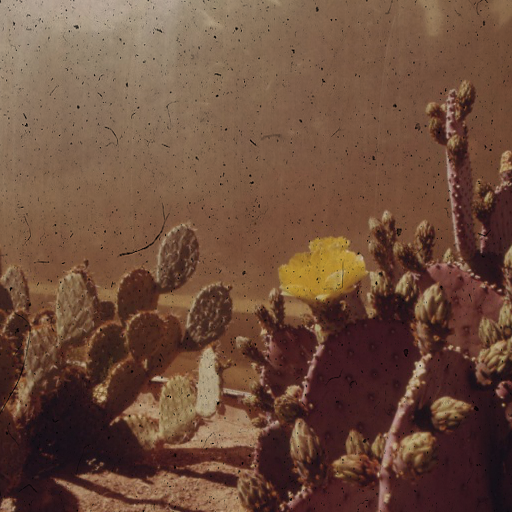

In [ ]:
src.train[97]

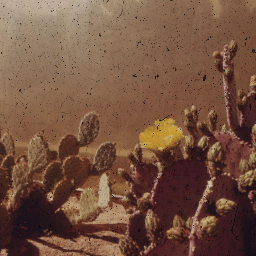

In [ ]:
src_256.train[97]

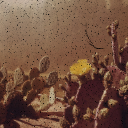

In [ ]:
src_128.train[97]

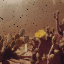

In [ ]:
src_64.train[97]

In [ ]:
def plots_f(img, rows, cols, width, height, **kwargs):
    [img.apply_tfms(tfms_gen[0], **kwargs).show(ax=ax) for i,ax in enumerate(plt.subplots(
        rows,cols,figsize=(width,height))[1].flatten())]

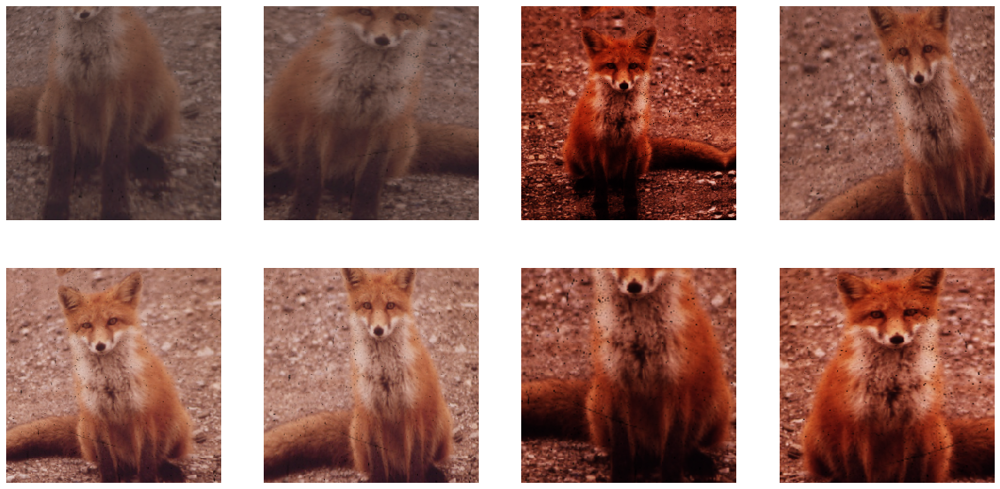

In [ ]:
plots_f(src_256.train[1133], 2, 4, 20, 10)

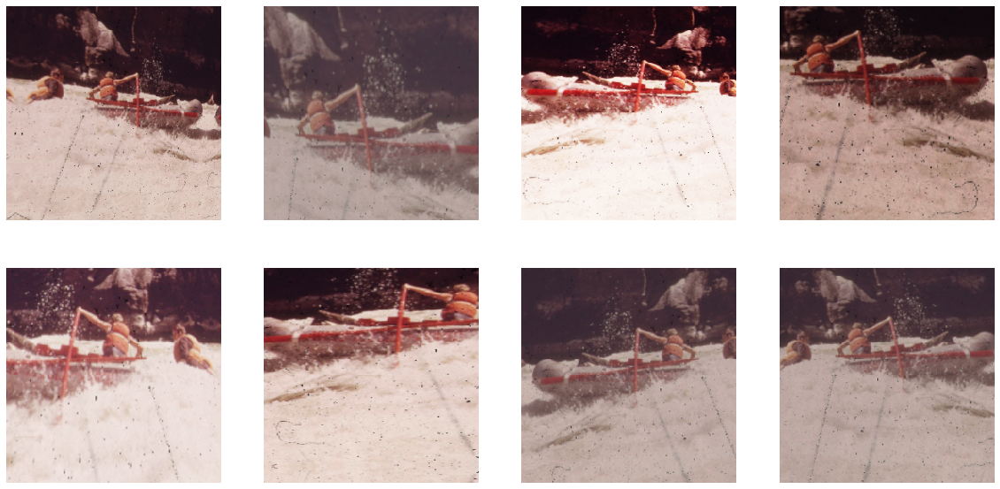

In [ ]:
plots_f(src_256.train[100], 2, 4, 20, 10)

We also create another ImageImageList which will hold the test set so that we can use `learn.validate()` on it. Fastai only allows for ground truth labels in validation.

In [ ]:
src_test = ImageImageList.from_df(df=df_images, path=path_lr, cols=['Filename']).split_by_idxs(train_idx=train.index.to_list(), valid_idx=test.index.to_list())
src_test

ItemLists;

Train: ImageImageList (4985 items)
Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512)
Path: /home/jupyter/documerica/dataset/dustified_512;

Valid: ImageImageList (624 items)
Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512)
Path: /home/jupyter/documerica/dataset/dustified_512;

Test: None

In [ ]:
src_test_256 = ImageImageList.from_df(df=df_images, path=path_lr_256, cols=['Filename']).split_by_idxs(train_idx=train.index.to_list(), valid_idx=test.index.to_list())
src_test_256

ItemLists;

Train: ImageImageList (4985 items)
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
Path: /home/jupyter/documerica/dataset/dustified_256;

Valid: ImageImageList (624 items)
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
Path: /home/jupyter/documerica/dataset/dustified_256;

Test: None

In [ ]:
src_test_128 = ImageImageList.from_df(df=df_images, path=path_lr_128, cols=['Filename']).split_by_idxs(train_idx=train.index.to_list(), valid_idx=test.index.to_list())
src_test_128

ItemLists;

Train: ImageImageList (4985 items)
Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128)
Path: /home/jupyter/documerica/dataset/dustified_128;

Valid: ImageImageList (624 items)
Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128)
Path: /home/jupyter/documerica/dataset/dustified_128;

Test: None

In [ ]:
src_test_64 = ImageImageList.from_df(df=df_images, path=path_lr_64, cols=['Filename']).split_by_idxs(train_idx=train.index.to_list(), valid_idx=test.index.to_list())
src_test_64

ItemLists;

Train: ImageImageList (4985 items)
Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64)
Path: /home/jupyter/documerica/dataset/dustified_64;

Valid: ImageImageList (624 items)
Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64)
Path: /home/jupyter/documerica/dataset/dustified_64;

Test: None

This is a helper function which will map the dusty images to their corresponding clean image, apply the chosen transformations to both, load them in a *DataBunch* object and normalize them using the dataset statistics (std and mean) which are calculated automatically. We pass the batch size and image size as well as the transforms of choice as arguments. Same transforms and normalization are applied both to the dusty and the clean images.

In [ ]:
def get_data(src, bs, size, tfms, path_hr):
    data = (src.label_from_func(lambda x: '{}/{}'.format(path_hr,os.path.basename(x))) # Ensure that we get the matching clean image for each dusty one
           .transform(tfms, size=size, tfm_y=True)
           .databunch(bs=bs).normalize(do_y=True))
    data.c = 3
    return data

I've monkey patched the fastai show results function so that it also displays the normalised difference between ground truth and prediction.

In [ ]:
def show_xyzdiffs(self, xs, ys, zs, imgsize:int=4, figsize:Optional[Tuple[int,int]]=None, **kwargs):
        "Show `xs` (inputs), `ys` (targets), `zs` (predictions) and `diffs` (differences)  on a figure of `figsize`."
        title = 'Input / Prediction / Target / Difference'
        axs = subplots(len(xs), 4, imgsize=imgsize, figsize=figsize, title=title, weight='bold', size=14)
        for i,(x,y,z) in enumerate(zip(xs,ys,zs)):
            x.show(ax=axs[i,0], **kwargs)
            y.show(ax=axs[i,2], **kwargs)
            z.show(ax=axs[i,1], **kwargs)
            np_diff = np.subtract(z.data.numpy(), y.data.numpy()).astype(np.float32)
            np_diff = (np_diff - np.min(np_diff))/np.ptp(np_diff)
            diff = Image(torch.from_numpy(np_diff).to(device))
            diff.show(ax=axs[i,3], **kwargs)

In [ ]:
def _show_results(self, ds_type=DatasetType.Valid, rows:int=5, **kwargs):
        "Show `rows` result of predictions on `ds_type` dataset."
        #TODO: get read of has_arg x and split_kwargs_by_func if possible
        #TODO: simplify this and refactor with pred_batch(...reconstruct=True)
        n_items = rows ** 2 if self.data.train_ds.x._square_show_res else rows
        if self.dl(ds_type).batch_size < n_items: n_items = self.dl(ds_type).batch_size
        ds = self.dl(ds_type).dataset
        self.callbacks.append(RecordOnCPU())
        preds = self.pred_batch(ds_type)
        *self.callbacks,rec_cpu = self.callbacks
        x,y = rec_cpu.input,rec_cpu.target
        norm = getattr(self.data,'norm',False)
        if norm:
            x = self.data.denorm(x)
            if norm.keywords.get('do_y',False):
                y     = self.data.denorm(y, do_x=True)
                preds = self.data.denorm(preds, do_x=True)
        analyze_kwargs,kwargs = split_kwargs_by_func(kwargs, ds.y.analyze_pred)
        preds = [ds.y.analyze_pred(grab_idx(preds, i), **analyze_kwargs) for i in range(n_items)]
        xs = [ds.x.reconstruct(grab_idx(x, i)) for i in range(n_items)]
        if has_arg(ds.y.reconstruct, 'x'):
            ys = [ds.y.reconstruct(grab_idx(y, i), x=x) for i,x in enumerate(xs)]
            zs = [ds.y.reconstruct(z, x=x) for z,x in zip(preds,xs)]
        else :
            ys = [ds.y.reconstruct(grab_idx(y, i)) for i in range(n_items)]
            zs = [ds.y.reconstruct(z) for z in preds]
        show_xyzdiffs(ds.x, xs, ys, zs, **kwargs)

# Hyperparams
These parameters are shared between all U-nets during progressive resizing.

The loss function we will use initially is Mean Square Error. *MSELossFlat()* is the same as MSE but the input and output are flattened.

For the architecture for the backbone if the U-Net we will use as our generator we choose *ResNet34* - ideally *ResNet50* or an even deeper ResNet could be used, but we run out of CUDA memory very quickly in that case and need to reset the notebook.

The chosen default weight decay is 1e-3, as this is advised as a good starting point for this hyperparameter in the fast.ai docs and tutorials. It will be handled using the method from "Fixing Weight Decay Regularization in Adam" ([paper](https://arxiv.org/abs/1711.05101)).

The parameter y_range corresponds to a sigmoid function applied to the activations obtained at the last step. These values are again the suggested default ones from the fast.ai docs and tutorials.

In [ ]:
arch = models.resnet34
wd = 1e-03 # weight decay
y_range = (-3.,3.)

In [ ]:
def ssim_metric(inputs, targets, window_size=7, size_average = True):
    ssim_metric = pytorch_ssim.ssim(inputs, targets, window_size, size_average)
    return ssim_metric

In [ ]:
class SSIM_metric(Callback):
    "Wrap a `func` in a callback for metrics computation."
    def __init__(self, func):
        # If it's a partial, use func.func
        name = getattr(func,'func',func).__name__
        self.func, self.name = func, name

    def on_epoch_begin(self, **kwargs):
        "Set the inner value to 0."
        self.val, self.count = 0.,0

    def on_batch_end(self, last_output, last_target, **kwargs):
        "Update metric computation with `last_output` and `last_target`."
        if not is_listy(last_target): last_target=[last_target]
        self.count += last_target[0].size(0)
        val = self.func(last_output, *last_target)
        self.val += last_target[0].size(0) * val.detach().cpu()

    def on_epoch_end(self, last_metrics, **kwargs):
        "Set the final result in `last_metrics`."
        return add_metrics(last_metrics, self.val/self.count)

# Feature Loss
This is a more complex loss function, using the activatins of another pre-trained network and gram matrix as perceptual loss.

In [ ]:
def gram_matrix(x):
    n,c,h,w = x.size()
    x = x.view(n, c, -1)
    return (x @ x.transpose(1,2))/(c*h*w)

In [ ]:
vgg_m = vgg16_bn(True).features.cuda().eval()
requires_grad(vgg_m, False)
blocks = [i-1 for i,o in enumerate(children(vgg_m)) if isinstance(o,nn.MaxPool2d)]

In [ ]:
blocks

[5, 12, 22, 32, 42]

In [ ]:
class FeatureLoss(nn.Module):
    def __init__(self, base_loss, m_feat, layer_ids, layer_wgts):
        super().__init__()
        self.m_feat = m_feat
        self.base_loss = base_loss
        self.loss_features = [self.m_feat[i] for i in layer_ids]
        self.hooks = hook_outputs(self.loss_features, detach=False)
        self.wgts = layer_wgts
        self.metric_names = ['MAE'] + [f'feat_L1_{i}' for i in range(len(layer_ids))
              ] + [f'feat_L1_gram_{i}' for i in range(len(layer_ids))]

    def make_features(self, x, clone=False):
        self.m_feat(x)
        return [(o.clone() if clone else o) for o in self.hooks.stored]
    
    def forward(self, input, target):
        out_feat = self.make_features(target, clone=True)
        in_feat = self.make_features(input)
        self.feat_losses = [self.base_loss(input,target)]
        self.feat_losses += [self.base_loss(f_in, f_out)*w
                             for f_in, f_out, w in zip(in_feat, out_feat, self.wgts)]
        self.feat_losses += [self.base_loss(gram_matrix(f_in), gram_matrix(f_out))*w**2 * 5e3
                             for f_in, f_out, w in zip(in_feat, out_feat, self.wgts)]
        self.metrics = dict(zip(self.metric_names, self.feat_losses))
        return sum(self.feat_losses)
    
    def __del__(self): self.hooks.remove()

In [ ]:
loss_gen = FeatureLoss(F.l1_loss, vgg_m, blocks, [2,4,5,6,6])

# First generator
## Progressive resizing stage one - 64 by 64 pixels
Our first generator will be a U-Net which will be trained on images of size 64 by 64 pixels.

In [ ]:
data_gen = get_data(src_64, 32, 64, tfms_gen, path_hr_64)

In [ ]:
data_gen

ImageDataBunch;

Train: LabelList (4985 items)
x: ImageImageList
Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64)
y: ImageList
Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64)
Path: /home/jupyter/documerica/dataset/dustified_64;

Valid: LabelList (623 items)
x: ImageImageList
Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64)
y: ImageList
Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64),Image (3, 64, 64)
Path: /home/jupyter/documerica/dataset/dustified_64;

Test: None

Show a batch of the data we loaded to see examples of image pairs. Note that images are slightly enlarged when visualised here so that we can see damaged sections a bit better.

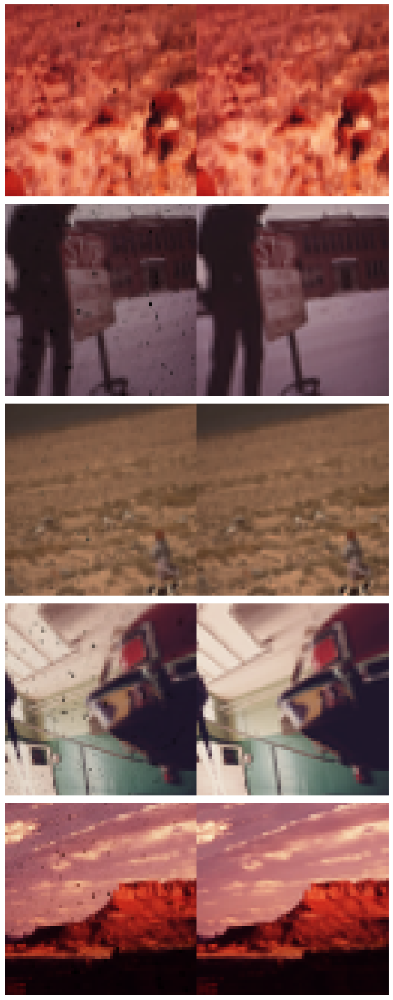

In [ ]:
data_gen.show_batch()

Connect to the wandb project instance for visualising and logging network performance.

In [ ]:
wandb.login()

True

In [ ]:
wandb.init(project=project_id, tags=['generator', 'pre-train', 'stage1', experiment_id])

wandb: Wandb version 0.8.31 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


W&B Run: https://app.wandb.ai/daniela-ivanova/ScratchRemovalFeatureLoss3/runs/3qsadnnk

The first generator is a U-Net with a ResNet34 backbone which takes 64 by 64 images as input. 

Self-attention is added via a self-attention layer at the third block before the end - idea from paper "Self-Attention Generative Adversarial Networks" ([paper](https://arxiv.org/abs/1805.08318)). 

Blur is used to avoid checkerboard artifacts at each layer - idea from "Super-Resolution using Convolutional Neural Networks without Any Checkerboard Artifacts" ([paper](https://arxiv.org/abs/1806.02658)). 

We also use weight normalization as suggested in the fast.ai tutorials for super resolution, since this is a similar task. "On the Effects of Batch and Weight Normalization in Generative Adversarial Networks" ([paper](https://arxiv.org/abs/1704.03971)) is a paper which supports the usage of weight normalisation for GANs.

In [ ]:
generator = unet_learner(data_gen, arch, wd=wd, blur=True, norm_type=NormType.Weight,
                         self_attention=True, y_range=y_range, loss_func=loss_gen, path=path, metrics=[mean_absolute_error, mean_squared_error, root_mean_squared_error, SSIM_metric(ssim_metric)]).to_fp16()

Print a summary of the network. We can see that not all parameters are trainable - all layer groups in the network are frozen but the last. The network is using weights from a *ResNet34* trained on ImageNet (provided by PyTorch), so we freeze the earlier layers that have already learned representations found in "natural" images (the encoder) and fine-tune the latter layers to the specific task of removing dust and scratches (the decoder part of the U-shape).

In [ ]:
generator.summary()

DynamicUnet
Layer (type)         Output Shape         Param #    Trainable 
Conv2d               [64, 32, 32]         9,408      False     
______________________________________________________________________
BatchNorm2d          [64, 32, 32]         128        True      
______________________________________________________________________
ReLU                 [64, 32, 32]         0          False     
______________________________________________________________________
MaxPool2d            [64, 16, 16]         0          False     
______________________________________________________________________
Conv2d               [64, 16, 16]         36,864     False     
______________________________________________________________________
BatchNorm2d          [64, 16, 16]         128        True      
______________________________________________________________________
ReLU                 [64, 16, 16]         0          False     
__________________________________________________

In [ ]:
generator.model

DynamicUnet(
  (layers): ModuleList(
    (0): Sequential(
      (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (4): Sequential(
        (0): BasicBlock(
          (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (relu): ReLU(inplace=True)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        )
        (1): BasicBlock(
          (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


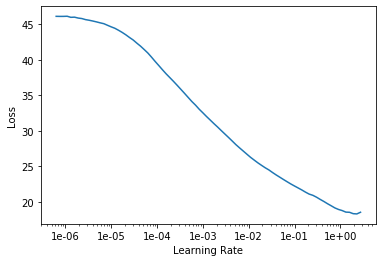

In [ ]:
generator.lr_find()
generator.recorder.plot()

We pass a *WandbCallback* instance so that the network training and validation performance is logged. Image visualisatons of Input/Prediction/Ground truth will be logged for each validation pass at the end of each epoch. Parameters and weights are also logged.

In [ ]:
wandb.config.update({"batch size": 32, 
                     "image size": 64,
                     "backbone": "resnet34",
                     "y_range": (-3.,3.),
                     "pct_start": 0.8,
                     "weight_decay": 1e-03,
                     "max_lr": 1e-03,
                     "loss": 'FeatureLossResNet',
                     "norm_type": NormType.Weight,
                     "self-attention": True,
                     "blur": True,
                     "frozen": True,
                     "half-precision": True}, allow_val_change=True)

wandb: Wandb version 0.8.31 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


In [ ]:
generator.callback_fns.append(partial(WandbCallback, input_type='images', log='all'))

In [ ]:
generator.callback_fns.append(partial(LossMetrics))

Finally, we can train the network for 10 epochs. 

We use one cycle policy to train the network more quickly. It is explaied in detail [here](https://docs.fast.ai/callbacks.one_cycle.html). 

We also set the percentage of overall number of iterations when learning rate rises during one cycle - in this case it is 80%.



The training and validation loss are recorded at the end of each epoch. The weights from the epoch with lowest validation loss will be automatically saved on the *wandb* instance (remote server).

In [ ]:
generator.fit_one_cycle(10, pct_start=0.8, max_lr=1e-03)

epoch,train_loss,valid_loss,mean_absolute_error,mean_squared_error,root_mean_squared_error,ssim_metric,MAE,feat_L1_0,feat_L1_1,feat_L1_2,feat_L1_3,feat_L1_4,feat_L1_gram_0,feat_L1_gram_1,feat_L1_gram_2,feat_L1_gram_3,feat_L1_gram_4,time
0,13.027900,11.160646,0.581148,0.512925,0.715704,0.091132,0.581148,0.216804,0.383492,0.320206,0.193391,0.451926,2.628633,2.492373,1.241992,0.434083,2.216598,00:27
1,6.602186,6.832561,0.230780,0.121596,0.348406,0.502220,0.230780,0.161426,0.266812,0.222635,0.134576,0.337390,0.980015,1.462758,0.803583,0.312659,1.919928,00:22
2,4.818269,5.457080,0.144636,0.043645,0.208735,0.733349,0.144636,0.101679,0.195300,0.177149,0.109252,0.285798,0.722923,1.119517,0.639613,0.260354,1.700860,00:21
3,4.127615,4.616656,0.109316,0.025636,0.159950,0.805481,0.109316,0.074480,0.158857,0.151121,0.094687,0.249784,0.558578,0.921825,0.544911,0.227772,1.525325,00:22
4,3.810458,4.134893,0.096322,0.020093,0.141606,0.837987,0.096322,0.066068,0.142451,0.135820,0.084930,0.225070,0.491378,0.807040,0.482565,0.203181,1.400067,00:22
5,3.613503,4.037014,0.095480,0.019243,0.138549,0.845051,0.095480,0.064304,0.136655,0.129375,0.080398,0.213938,0.540261,0.782990,0.460964,0.192115,1.340531,00:22
6,3.428019,4.001905,0.092112,0.017553,0.132361,0.848501,0.092112,0.063376,0.132947,0.126133,0.078743,0.209383,0.576142,0.772357,0.449999,0.189477,1.311237,00:22
7,3.301069,3.729572,0.088576,0.017075,0.130477,0.852501,0.088576,0.059982,0.128657,0.122065,0.076260,0.203166,0.453336,0.704466,0.429552,0.183234,1.280278,00:23
8,3.117410,3.517363,0.085759,0.015776,0.125428,0.859940,0.085759,0.058141,0.124562,0.118786,0.074041,0.196814,0.373646,0.647829,0.412611,0.177243,1.247929,00:22
9,2.962179,3.413897,0.083572,0.015030,0.122441,0.862464,0.083572,0.056992,0.122681,0.117364,0.073216,0.193725,0.341901,0.621916,0.403940,0.174707,1.223884,00:23


wandb: Wandb version 0.8.31 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


Better model found at epoch 0 with valid_loss value: 11.160646438598633.
Better model found at epoch 1 with valid_loss value: 6.832561016082764.
Better model found at epoch 2 with valid_loss value: 5.457079887390137.
Better model found at epoch 3 with valid_loss value: 4.616656303405762.
Better model found at epoch 4 with valid_loss value: 4.13489294052124.
Better model found at epoch 5 with valid_loss value: 4.037013530731201.
Better model found at epoch 6 with valid_loss value: 4.00190544128418.
Better model found at epoch 7 with valid_loss value: 3.72957181930542.
Better model found at epoch 8 with valid_loss value: 3.5173630714416504.
Better model found at epoch 9 with valid_loss value: 3.4138970375061035.
Loaded best saved model from /home/jupyter/wandb/run-20200403_214400-3qsadnnk/bestmodel.pth


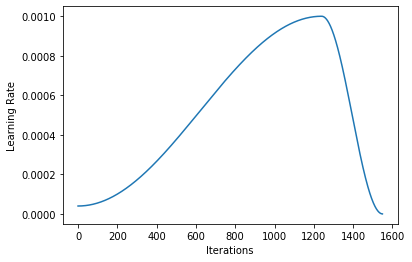

In [ ]:
generator.recorder.plot_lr()

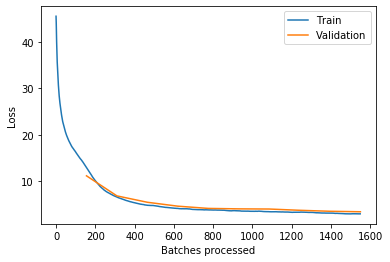

In [ ]:
generator.recorder.plot_losses()

Once training finishes, visualise results from the validation set.

In [ ]:
generator.show_results = _show_results

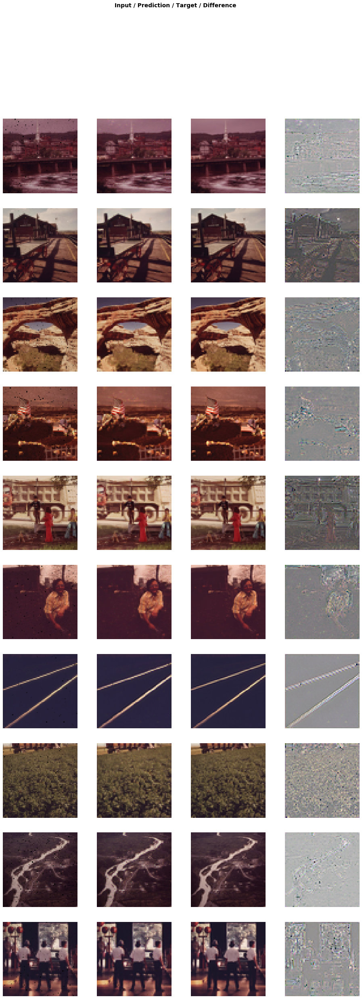

In [ ]:
generator.show_results(generator, rows=10)

To save the model weights, run this.

In [ ]:
generator.save('gen-pre-64-frozen-'+experiment_id)

In [ ]:
del generator
del data_gen

# Second generator
## Progressive resizing stage 2 - 128 by 128 pixels
The second generator is again a U-Net with *ResNet34* backbone. It takes 128 by 128 pixel image input. It will incorporate the weights and layers from the previous, smaller network that was trained.


In [ ]:
data_gen = get_data(src_128, 16, 128, tfms_gen, path_hr_128)

In [ ]:
data_gen

ImageDataBunch;

Train: LabelList (4985 items)
x: ImageImageList
Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128)
y: ImageList
Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128)
Path: /home/jupyter/documerica/dataset/dustified_128;

Valid: LabelList (623 items)
x: ImageImageList
Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128)
y: ImageList
Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128),Image (3, 128, 128)
Path: /home/jupyter/documerica/dataset/dustified_128;

Test: None

Display image pairs from a random batch. 

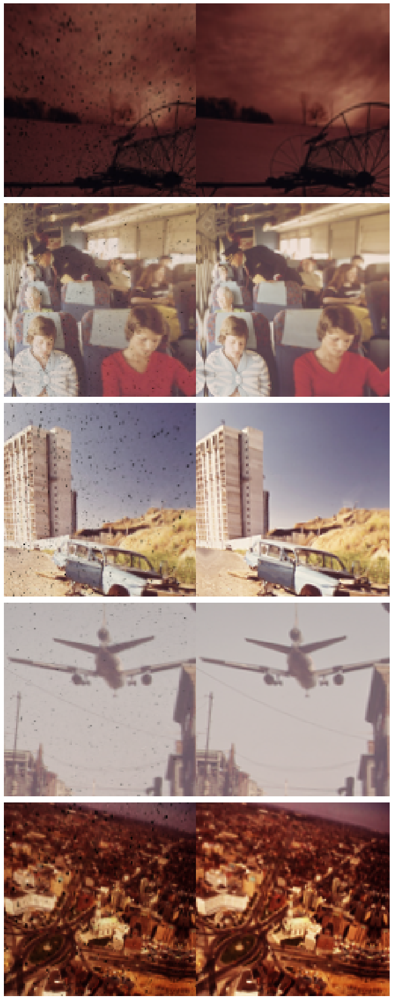

In [ ]:
data_gen.show_batch(imgsize=5)

Update the *wandb* run.

In [ ]:
wandb.init(project=project_id, tags=['generator', 'pre-train', 'stage2', experiment_id])

wandb: Wandb version 0.8.31 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


W&B Run: https://app.wandb.ai/daniela-ivanova/ScratchRemovalFeatureLoss3/runs/26io1uu9

Now create the new generator with the dataset of larger images. The hyperparameters are the same as in the first U-Net. We also use the weights from the previous network - *fast.ai* automatically takes care of incorporating them into the larger U-Net at the corresponding layers. We load the weights from the network run which had the smallest validation loss.

In [ ]:
generator = unet_learner(data_gen, arch, wd=wd, blur=True, norm_type=NormType.Weight,
                         self_attention=True, y_range=y_range, loss_func=loss_gen, path=path, metrics=[mean_absolute_error, mean_squared_error, root_mean_squared_error, SSIM_metric(ssim_metric)]).load('gen-pre-64-frozen-'+experiment_id).to_fp16()

Print the network summary. Not all parameters are trainable (frozen).

In [ ]:
generator.summary()

DynamicUnet
Layer (type)         Output Shape         Param #    Trainable 
Conv2d               [64, 64, 64]         9,408      False     
______________________________________________________________________
BatchNorm2d          [64, 64, 64]         128        True      
______________________________________________________________________
ReLU                 [64, 64, 64]         0          False     
______________________________________________________________________
MaxPool2d            [64, 32, 32]         0          False     
______________________________________________________________________
Conv2d               [64, 32, 32]         36,864     False     
______________________________________________________________________
BatchNorm2d          [64, 32, 32]         128        True      
______________________________________________________________________
ReLU                 [64, 32, 32]         0          False     
__________________________________________________

Train the generator and use a *WandbCallback* to record logs.

In [ ]:
generator.model

DynamicUnet(
  (layers): ModuleList(
    (0): Sequential(
      (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (4): Sequential(
        (0): BasicBlock(
          (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (relu): ReLU(inplace=True)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        )
        (1): BasicBlock(
          (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05

In [ ]:
generator.layer_groups

[Sequential(
   (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
   (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   (2): ReLU(inplace=True)
   (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
   (4): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
   (5): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   (6): ReLU(inplace=True)
   (7): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
   (8): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   (9): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
   (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   (11): ReLU(inplace=True)
   (12): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
   (13): BatchNorm2d(64, eps=1e-05, mom

In [ ]:
wandb.config.update({"batch size": 16, 
                     "image size": 128,
                     "backbone": "resnet34",
                     "y_range": (-3.,3.),
                     "pct_start": 0.8,
                     "weight_decay": 1e-03,
                     "max_lr": 1e-03,
                     "loss": 'FeaturLossResNet',
                     "norm_type": NormType.Weight,
                     "self-attention": True,
                     "blur": True,
                     "frozen": True,
                     "half-precision": True}, allow_val_change=True)

wandb: Wandb version 0.8.31 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


In [ ]:
generator.callback_fns.append(partial(WandbCallback, input_type='images', log='all'))

In [ ]:
generator.callback_fns.append(partial(LossMetrics))

In [ ]:
generator.fit_one_cycle(10, pct_start=0.8, max_lr=1e-03)

epoch,train_loss,valid_loss,mean_absolute_error,mean_squared_error,root_mean_squared_error,ssim_metric,MAE,feat_L1_0,feat_L1_1,feat_L1_2,feat_L1_3,feat_L1_4,feat_L1_gram_0,feat_L1_gram_1,feat_L1_gram_2,feat_L1_gram_3,feat_L1_gram_4,time
0,2.162398,2.598390,0.079295,0.013359,0.115286,0.836370,0.079295,0.055567,0.125700,0.117349,0.063175,0.160716,0.341050,0.519701,0.256980,0.090377,0.788481,01:09
1,2.109010,2.583159,0.081750,0.014012,0.118040,0.835296,0.081750,0.055262,0.124264,0.116126,0.062423,0.158494,0.361423,0.506699,0.251138,0.088607,0.776974,00:49
2,2.055287,2.609133,0.082981,0.014154,0.118666,0.839087,0.082981,0.055092,0.123046,0.115330,0.062102,0.157834,0.402602,0.499834,0.247137,0.088380,0.774795,00:50
3,2.066329,3.035460,0.084424,0.015063,0.122423,0.825612,0.084424,0.057120,0.130279,0.122479,0.066904,0.171752,0.576651,0.621755,0.270776,0.094129,0.839191,00:49
4,2.118541,2.632108,0.081926,0.013761,0.117012,0.848623,0.081926,0.055550,0.121212,0.113917,0.060999,0.153939,0.462532,0.501316,0.238355,0.084178,0.758183,00:49
5,2.042466,2.490014,0.084395,0.014572,0.120353,0.850270,0.084395,0.053445,0.118177,0.110593,0.059179,0.149751,0.392819,0.468898,0.229632,0.081826,0.741299,00:50
6,2.111458,2.541339,0.081963,0.013598,0.116295,0.847615,0.081963,0.055305,0.119870,0.111863,0.059812,0.151425,0.434712,0.468180,0.229883,0.082122,0.746205,00:50
7,2.060564,2.539349,0.078838,0.012805,0.112882,0.855587,0.078838,0.053714,0.117407,0.110323,0.058628,0.148866,0.457471,0.471275,0.224480,0.080198,0.738150,00:50
8,1.883817,2.388310,0.076727,0.012300,0.110599,0.862455,0.076727,0.051860,0.114265,0.107128,0.056701,0.143260,0.404034,0.431955,0.213232,0.077109,0.712039,00:50
9,1.735588,2.126762,0.072266,0.011156,0.105351,0.866359,0.072266,0.049845,0.110979,0.103849,0.054574,0.137387,0.274323,0.368565,0.197649,0.073195,0.684130,00:49


Better model found at epoch 0 with valid_loss value: 2.5983901023864746.


wandb: Wandb version 0.8.31 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


Better model found at epoch 1 with valid_loss value: 2.5831594467163086.
Better model found at epoch 5 with valid_loss value: 2.490013599395752.
Better model found at epoch 8 with valid_loss value: 2.388309955596924.
Better model found at epoch 9 with valid_loss value: 2.1267621517181396.
Loaded best saved model from /home/jupyter/wandb/run-20200403_215142-26io1uu9/bestmodel.pth


In [ ]:
generator.show_results = _show_results

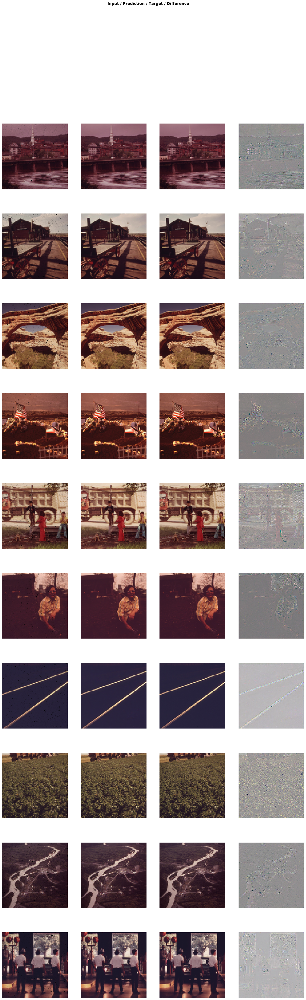

In [ ]:
generator.show_results(generator, rows=10, figsize=(20,60))

Save the network.

In [ ]:
generator.save('gen-pre-128-frozen-'+experiment_id)

In [ ]:
del generator
del data_gen

# Third Generator
## Progressive resizing stage 3 - 256 by 256 pixels
The next stage of progressive resizing is to train a U-Net generator which takes 256 by 256 pixel images as input.

In [ ]:
data_gen = get_data(src_256, 8, 256, tfms_gen, path_hr_256)

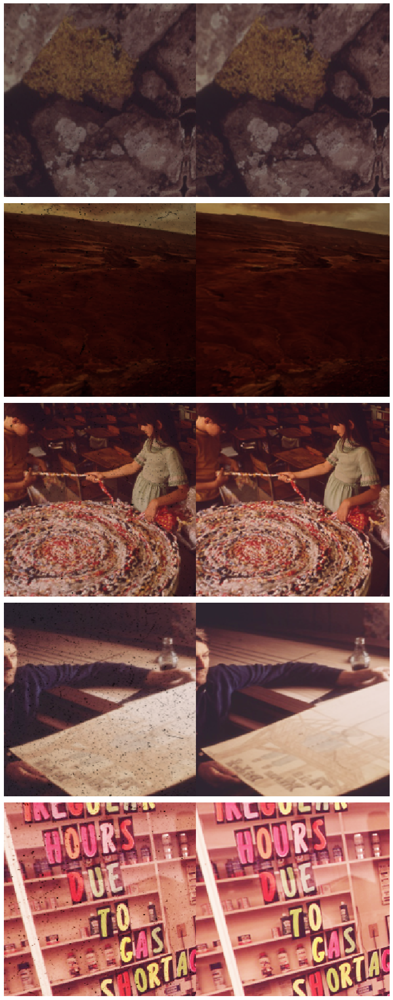

In [ ]:
data_gen.show_batch(imgsize=5)

Then load new generator with 256 pixel input using the weights learned by the U-Net with 128 pixel input.

In [ ]:
generator = unet_learner(data_gen, arch, wd=wd, blur=True, norm_type=NormType.Weight,
                         self_attention=True, y_range=y_range, loss_func=loss_gen, path=path, metrics=[mean_absolute_error, mean_squared_error, root_mean_squared_error, SSIM_metric(ssim_metric)]).load('gen-pre-128-frozen-'+experiment_id).to_fp16()

Print generator summary.

In [ ]:
generator.summary()

DynamicUnet
Layer (type)         Output Shape         Param #    Trainable 
Conv2d               [64, 128, 128]       9,408      False     
______________________________________________________________________
BatchNorm2d          [64, 128, 128]       128        True      
______________________________________________________________________
ReLU                 [64, 128, 128]       0          False     
______________________________________________________________________
MaxPool2d            [64, 64, 64]         0          False     
______________________________________________________________________
Conv2d               [64, 64, 64]         36,864     False     
______________________________________________________________________
BatchNorm2d          [64, 64, 64]         128        True      
______________________________________________________________________
ReLU                 [64, 64, 64]         0          False     
__________________________________________________

In [ ]:
generator.model

DynamicUnet(
  (layers): ModuleList(
    (0): Sequential(
      (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (4): Sequential(
        (0): BasicBlock(
          (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (relu): ReLU(inplace=True)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        )
        (1): BasicBlock(
          (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05

In [ ]:
generator.layer_groups

[Sequential(
   (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
   (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   (2): ReLU(inplace=True)
   (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
   (4): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
   (5): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   (6): ReLU(inplace=True)
   (7): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
   (8): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   (9): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
   (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   (11): ReLU(inplace=True)
   (12): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
   (13): BatchNorm2d(64, eps=1e-05, mom

Append wandb to the network's callbacks.

In [ ]:
wandb.init(project=project_id, tags=['generator', 'pre-train', experiment_id])

wandb: Wandb version 0.8.31 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


W&B Run: https://app.wandb.ai/daniela-ivanova/ScratchRemovalFeatureLoss3/runs/1m6zct5u

In [ ]:
wandb.config.update({"batch size": 8, 
                     "image size": 256,
                     "backbone": "resnet34",
                     "y_range": (-3.,3.),
                     "pct_start": 0.8,
                     "weight_decay": 1e-03,
                     "max_lr": 1e-03,
                     "loss": 'FeatureLossResNet',
                     "norm_type": NormType.Weight,
                     "self-attention": True,
                     "blur": True,
                     "frozen": True,
                     "half-precision": True}, allow_val_change=True)

wandb: Wandb version 0.8.31 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


In [ ]:
generator.callback_fns.append(partial(WandbCallback, input_type='images', log='all'))

In [ ]:
generator.callback_fns.append(partial(LossMetrics))

Train the generator on new data.

In [ ]:
generator.fit_one_cycle(10, pct_start=0.8, max_lr=1e-03)

epoch,train_loss,valid_loss,mean_absolute_error,mean_squared_error,root_mean_squared_error,ssim_metric,MAE,feat_L1_0,feat_L1_1,feat_L1_2,feat_L1_3,feat_L1_4,feat_L1_gram_0,feat_L1_gram_1,feat_L1_gram_2,feat_L1_gram_3,feat_L1_gram_4,time
0,1.658162,1.810423,0.081603,0.014601,0.120094,0.846805,0.081603,0.049770,0.114023,0.104408,0.049467,0.108662,0.371578,0.374677,0.135483,0.040136,0.380616,02:43
1,1.701044,1.731138,0.076983,0.013206,0.114121,0.850899,0.076983,0.048481,0.112181,0.102572,0.048486,0.106324,0.330941,0.365242,0.129055,0.038525,0.372349,02:30
2,1.731299,1.867902,0.083942,0.015309,0.122832,0.840371,0.083942,0.049086,0.113601,0.104084,0.049651,0.109463,0.374808,0.419443,0.140280,0.041171,0.382373,02:30
3,1.734233,1.690511,0.071809,0.012073,0.109024,0.854428,0.071809,0.047873,0.112632,0.103804,0.049064,0.107082,0.295711,0.349160,0.137607,0.040646,0.375123,02:30
4,1.732940,1.908271,0.086453,0.015695,0.124499,0.837740,0.086453,0.050335,0.112381,0.103086,0.049108,0.107966,0.458891,0.387219,0.135005,0.039564,0.378263,02:30
5,1.802891,1.978502,0.075882,0.012545,0.111332,0.850086,0.075882,0.050075,0.111744,0.102441,0.048773,0.107403,0.526800,0.403078,0.134898,0.039327,0.378081,02:31
6,1.786556,1.727541,0.074433,0.012538,0.111073,0.852600,0.074433,0.047274,0.110362,0.101261,0.047961,0.105488,0.335723,0.366585,0.128995,0.038424,0.371035,02:32
7,1.688719,1.770592,0.081290,0.014509,0.119567,0.849857,0.081290,0.047959,0.110585,0.101813,0.048407,0.106768,0.356061,0.373514,0.130557,0.038985,0.374652,02:31
8,1.621619,1.614152,0.070399,0.011804,0.107671,0.861304,0.070399,0.046044,0.107682,0.099120,0.046901,0.102551,0.292730,0.330140,0.121659,0.036830,0.360096,02:31
9,1.522142,1.528181,0.068581,0.011392,0.105661,0.865460,0.068581,0.045478,0.105451,0.096552,0.045439,0.098936,0.272846,0.298876,0.112878,0.035338,0.347808,02:31


Better model found at epoch 0 with valid_loss value: 1.8104233741760254.


wandb: Wandb version 0.8.31 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


Better model found at epoch 1 with valid_loss value: 1.7311384677886963.
Better model found at epoch 3 with valid_loss value: 1.690510630607605.
Better model found at epoch 8 with valid_loss value: 1.614151954650879.
Better model found at epoch 9 with valid_loss value: 1.5281814336776733.
Loaded best saved model from /home/jupyter/wandb/run-20200403_220404-1m6zct5u/bestmodel.pth


In [ ]:
generator.show_results = _show_results

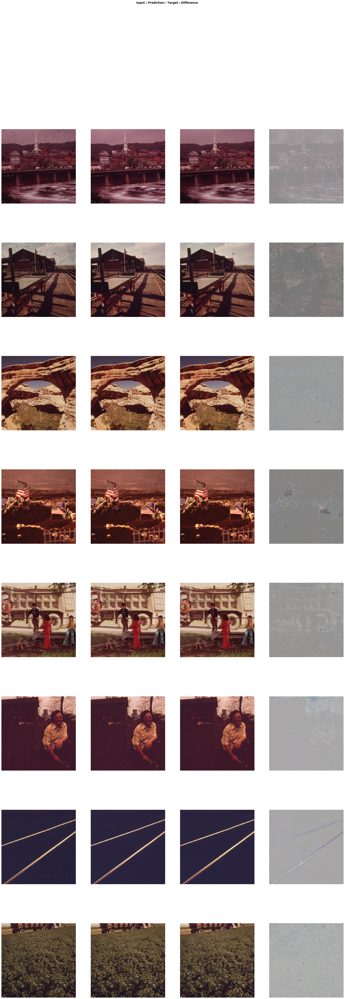

In [ ]:
generator.show_results(generator, rows=10, figsize=(30,80))

Save the network.

In [ ]:
generator.save('gen-pre-256-frozen-'+experiment_id)

In [ ]:
del generator
del data_gen

# Unfreeze the Generator
## Fine-tuning all parameters - 256 by 256 pixels
The last stage of is to train the unfrozen generator which takes 256 by 256 pixel images as input.

In [ ]:
data_gen = get_data(src_256, 8, 256, tfms_gen, path_hr_256)

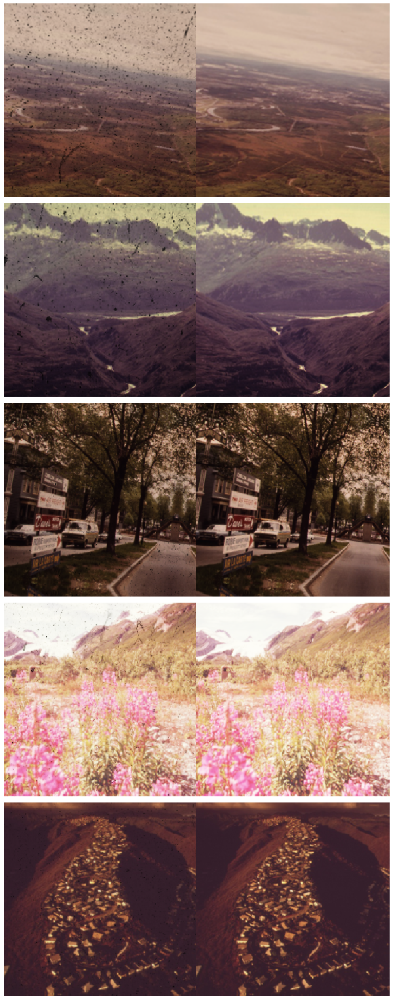

In [ ]:
data_gen.show_batch(imgsize=5)

Then load new generator with 256 pixel input using the weights learned by the frozen U-Net with 256 pixel input.

In [ ]:
generator = unet_learner(data_gen, arch, wd=wd, blur=True, norm_type=NormType.Weight,
                         self_attention=True, y_range=y_range, loss_func=loss_gen, path=path, metrics=[mean_absolute_error, mean_squared_error, root_mean_squared_error, SSIM_metric(ssim_metric)]).load('gen-pre-256-frozen-'+experiment_id).to_fp16()

Now unfreeze it.

In [ ]:
generator.unfreeze()

Print generator summary.

In [ ]:
generator.summary()

DynamicUnet
Layer (type)         Output Shape         Param #    Trainable 
Conv2d               [64, 128, 128]       9,408      True      
______________________________________________________________________
BatchNorm2d          [64, 128, 128]       128        True      
______________________________________________________________________
ReLU                 [64, 128, 128]       0          False     
______________________________________________________________________
MaxPool2d            [64, 64, 64]         0          False     
______________________________________________________________________
Conv2d               [64, 64, 64]         36,864     True      
______________________________________________________________________
BatchNorm2d          [64, 64, 64]         128        True      
______________________________________________________________________
ReLU                 [64, 64, 64]         0          False     
__________________________________________________

In [ ]:
generator.model

DynamicUnet(
  (layers): ModuleList(
    (0): Sequential(
      (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (4): Sequential(
        (0): BasicBlock(
          (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (relu): ReLU(inplace=True)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        )
        (1): BasicBlock(
          (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05

In [ ]:
generator.layer_groups

[Sequential(
   (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
   (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   (2): ReLU(inplace=True)
   (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
   (4): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
   (5): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   (6): ReLU(inplace=True)
   (7): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
   (8): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   (9): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
   (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   (11): ReLU(inplace=True)
   (12): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
   (13): BatchNorm2d(64, eps=1e-05, mom

We will use discriminatove learning rates, so that earlier llayers are trained with a much smaller learning rate.

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


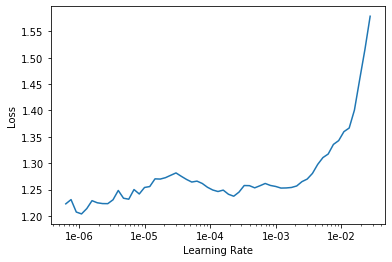

In [ ]:
generator.lr_find()
generator.recorder.plot()

Append wandb to the network's callbacks.

In [ ]:
wandb.init(project=project_id, tags=['generator', 'pre-train', experiment_id])

wandb: Wandb version 0.8.31 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


W&B Run: https://app.wandb.ai/daniela-ivanova/ScratchRemovalFeatureLoss3/runs/36jmwa4k

In [ ]:
wandb.config.update({"batch size": 8, 
                     "image size": 256,
                     "backbone": "resnet34",
                     "y_range": (-3.,3.),
                     "pct_start": 0.5,
                     "weight_decay": 1e-03,
                     "max_lr": (1e-05, 1e-03),
                     "loss": 'FeatureLossResNet',
                     "norm_type": NormType.Weight,
                     "self-attention": True,
                     "blur": True,
                     "frozen": False,
                     "half-precision": True}, allow_val_change=True)

wandb: Wandb version 0.8.31 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


In [ ]:
generator.callback_fns.append(partial(WandbCallback, input_type='images', log='all'))

In [ ]:
generator.callback_fns.append(partial(LossMetrics))

Train the generator on new data.

In [ ]:
generator.fit_one_cycle(20, pct_start=0.5, max_lr=slice(1e-05,1e-03))

epoch,train_loss,valid_loss,mean_absolute_error,mean_squared_error,root_mean_squared_error,ssim_metric,MAE,feat_L1_0,feat_L1_1,feat_L1_2,feat_L1_3,feat_L1_4,feat_L1_gram_0,feat_L1_gram_1,feat_L1_gram_2,feat_L1_gram_3,feat_L1_gram_4,time
0,1.017450,1.267438,0.052609,0.006368,0.079172,0.872269,0.052609,0.036115,0.093986,0.092313,0.043555,0.093042,0.152117,0.246389,0.110327,0.034774,0.312210,02:36
1,1.061366,1.286174,0.055302,0.006795,0.081737,0.871071,0.055302,0.036207,0.093413,0.091278,0.043133,0.092491,0.167590,0.252232,0.109464,0.034452,0.310612,02:37
2,1.059778,1.289385,0.054715,0.006501,0.079897,0.870427,0.054715,0.036002,0.093593,0.092057,0.043514,0.093236,0.166319,0.255175,0.108392,0.034178,0.312204,02:36
3,1.068243,1.305311,0.048866,0.005686,0.074787,0.877298,0.048866,0.035674,0.093231,0.091937,0.043591,0.093612,0.167243,0.272437,0.111427,0.034074,0.313220,02:37
4,1.108059,1.259578,0.052904,0.006545,0.080087,0.878476,0.052904,0.035921,0.092859,0.091403,0.043080,0.092194,0.158584,0.241623,0.107628,0.033816,0.309566,02:36
5,1.120022,1.275807,0.053756,0.006144,0.077913,0.871340,0.053756,0.035627,0.091956,0.090843,0.042938,0.091993,0.166746,0.251138,0.109321,0.033845,0.307644,02:37
6,1.128124,1.260344,0.049156,0.005523,0.073852,0.884798,0.049156,0.035757,0.091298,0.089783,0.042383,0.090305,0.179587,0.237531,0.108087,0.033939,0.302519,02:37
7,1.167475,1.404149,0.055758,0.006358,0.079246,0.866928,0.055758,0.036916,0.093649,0.091729,0.043517,0.093372,0.226434,0.301144,0.114588,0.034311,0.312730,02:37
8,1.121345,1.341105,0.059873,0.007335,0.084954,0.860352,0.059873,0.036812,0.093452,0.091807,0.043505,0.092856,0.202398,0.261684,0.112707,0.035136,0.310877,02:38
9,1.155416,1.377069,0.065291,0.009108,0.094370,0.857409,0.065291,0.036901,0.093672,0.091641,0.043173,0.092288,0.218402,0.281640,0.111074,0.033953,0.309033,02:37


Better model found at epoch 0 with valid_loss value: 1.2674381732940674.


wandb: Wandb version 0.8.31 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


Better model found at epoch 4 with valid_loss value: 1.259577751159668.
Better model found at epoch 11 with valid_loss value: 1.2510135173797607.
Better model found at epoch 13 with valid_loss value: 1.2081795930862427.
Better model found at epoch 14 with valid_loss value: 1.187355875968933.
Better model found at epoch 15 with valid_loss value: 1.1772503852844238.
Better model found at epoch 16 with valid_loss value: 1.1624244451522827.
Better model found at epoch 17 with valid_loss value: 1.1497552394866943.
Better model found at epoch 18 with valid_loss value: 1.114587426185608.
Loaded best saved model from /home/jupyter/wandb/run-20200403_223910-36jmwa4k/bestmodel.pth


In [ ]:
generator.show_results = _show_results

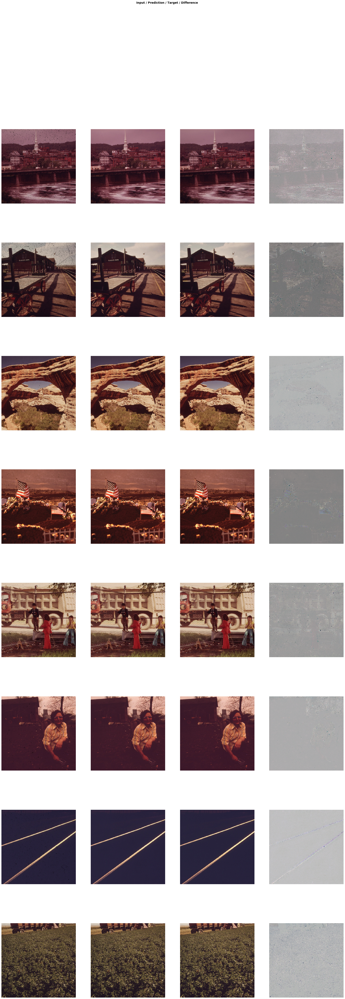

In [ ]:
generator.show_results(generator, rows=10, figsize=(30,80))

Save the network.

In [ ]:
generator.save('gen-pre-256-unfrozen-'+experiment_id)

In [ ]:
del generator
del data_gen

# Evaluate generator on test data

In [ ]:
src_test_256_clean = ImageImageList.from_df(df=df_images, path=path_hr_256, cols=['Filename']).split_by_idxs(train_idx=train.index.to_list(), valid_idx=test.index.to_list())
src_test_256_clean

ItemLists;

Train: ImageImageList (4985 items)
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
Path: /home/jupyter/documerica/dataset/clean_256;

Valid: ImageImageList (624 items)
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
Path: /home/jupyter/documerica/dataset/clean_256;

Test: None

In [ ]:
tfms_test = get_transforms(do_flip=False, max_zoom=1., max_lighting=None, max_rotate=None, max_warp=None)

In [ ]:
data_gen_test = get_data(src_test_256, 1, 256, tfms_test, path_hr_256)

In [ ]:
data_gen_test_clean = get_data(src_test_256_clean, 1, 256, tfms_test, path_hr_256)

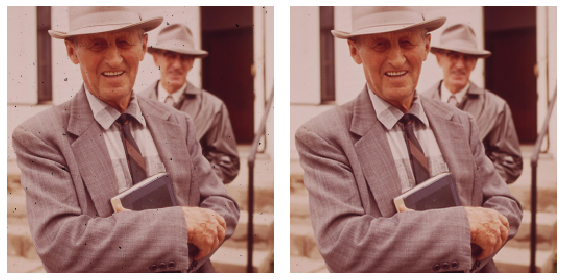

In [ ]:
data_gen_test.show_batch()

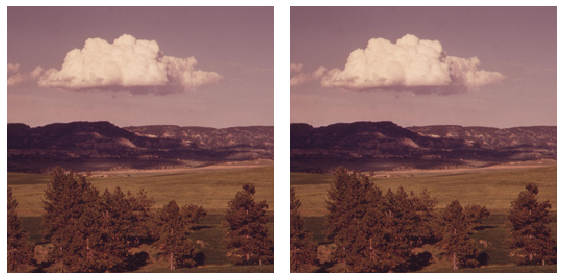

In [ ]:
data_gen_test_clean.show_batch()

In [ ]:
def ssim_eval(inputs, targets, window_size=3, size_average = True, **kwargs):
    ssim = pytorch_ssim.ssim(inputs, targets, window_size, size_average)
    return ssim
    

class SSIM_metric_eval(nn.Module):
    def __init__(self, window_size=7, size_average=True, per_channel=False):
        super().__init__()
        self.size_average = size_average
        self.window_size = window_size
        self.per_channel = per_channel
        
    def forward(self, input, target, **kwargs):
        ssim_per_chan = []
        ssim_per_chan.append(ssim_eval(input, target, window_size=self.window_size, size_average=self.size_average, **kwargs))
        if self.per_channel:
            input_channels = torch.chunk(input,3,1)
            target_channels = torch.chunk(target,3,1)
            for i in range(3):
                ssim_per_chan.append(ssim_eval(input_channels[i], target_channels[i], window_size=self.window_size, size_average=self.size_average, **kwargs))
        return torch.Tensor(ssim_per_chan)

In [ ]:
def ssim_init(data1, data2):
    ssim_dusty_clean = []
    ssim_clean_clean = []
    for i in iter(data1.valid_dl):
        ssim_dusty_clean.append(ssim_eval(i[0],i[1]).item())
    
    for i in iter(data2.valid_dl):
        ssim_clean_clean.append(ssim_eval(i[0],i[1]).item())
        
    return pd.DataFrame({'SSIM(clean, clean)': ssim_clean_clean, 'SSIM(dusty, clean)': ssim_dusty_clean})

In [ ]:
ssim_data = ssim_init(data_gen_test, data_gen_test_clean)

In [ ]:
ssim_data

,"SSIM(clean, clean)","SSIM(dusty, clean)"
0,1.0,0.594658
1,1.0,0.782398
2,1.0,0.637052
3,1.0,0.368799
4,1.0,0.805644
...,...,...
619,1.0,0.586413
620,1.0,0.676432
621,1.0,0.687071
622,1.0,0.744172


In [ ]:
from matplotlib.lines import Line2D

def plot_ssim(df, n_rows, n_cols, title, x_label, y_label, colours, figsize=(15,5)):
    fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols)
    for i, c in enumerate(df.columns):
        curr_ax = df[c].plot(kind='hist', ax=axes.flatten()[i], figsize=figsize, title=c, bins=100, color=colours[i], range=(0.0, 1.0))
        if df[c].mean() != 1:
            curr_ax.axvline(df[c].mean(), color='k', linestyle='dashed', linewidth=1)
            curr_ax.axvline(df[c].mean()+df[c].std(), color='k', linestyle='dotted', linewidth=1)
            curr_ax.axvline(df[c].mean()-df[c].std(), color='k', linestyle='dotted', linewidth=1)
            min_ylim, max_ylim = plt.ylim()
            #curr_ax.text(df[c].mean()*1.1, max_ylim*0.9, 'Mean: {:.2f}'.format(df[c].mean()))
            #curr_ax.text(df[c].mean()*1.1, max_ylim*0.8, 'SD: {:.2f}'.format(df[c].std()))
            lines = [Line2D([0], [0], color='k', linewidth=3, linestyle='dashed'), Line2D([0], [0], color='k', linestyle='dotted')]
            labels = ['Mean: {:.2f}'.format(df[c].mean()), 'SD: {:.2f}'.format(df[c].std())]
            curr_ax.legend(lines, labels, loc="upper left")
    plt.suptitle(title, x=0.5, y=1.05, ha='center', fontsize='x-large')
    for ax in axes.flatten():
        ax.grid(False)
    fig.text(0.5, 0.001, x_label, ha='center', fontsize='larger')

In [ ]:
def plot_delta(df, n_rows, n_cols, title, x_label, y_label, colours, figsize=(15,5)):
    fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols)
    for i, c in enumerate(df.columns):
        curr_ax = df[c].plot(kind='hist', ax=axes, figsize=figsize, title=c, bins=100, color=colours[i], range=(-0.5, 0.5))
        if df[c].mean() != 1:
            curr_ax.axvline(df[c].mean(), color='k', linestyle='dashed', linewidth=1)
            curr_ax.axvline(df[c].mean()+df[c].std(), color='k', linestyle='dotted', linewidth=1)
            curr_ax.axvline(df[c].mean()-df[c].std(), color='k', linestyle='dotted', linewidth=1)
            min_ylim, max_ylim = plt.ylim()
            #curr_ax.text(df[c].mean()*1.1, max_ylim*0.9, 'Mean: {:.2f}'.format(df[c].mean()))
            #curr_ax.text(df[c].mean()*1.1, max_ylim*0.8, 'SD: {:.2f}'.format(df[c].std()))
            lines = [Line2D([0], [0], color='k', linewidth=3, linestyle='dashed'), Line2D([0], [0], color='k', linestyle='dotted')]
            labels = ['Mean: {:.2f}'.format(df[c].mean()), 'SD: {:.2f}'.format(df[c].std())]
            curr_ax.legend(lines, labels, loc="upper left")
    plt.suptitle(title, x=0.5, y=1.05, ha='center', fontsize='x-large')
    axes.grid(False)
    fig.text(0.5, 0.001, x_label, ha='center', fontsize='larger')

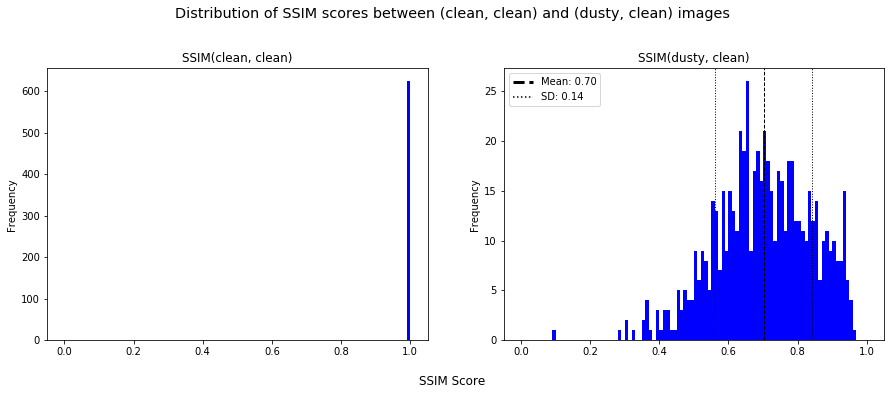

In [ ]:
plot_ssim(ssim_data, 1, 2, 'Distribution of SSIM scores between (clean, clean) and (dusty, clean) images', 'SSIM Score', 'Frequency', ['blue', 'blue'])

In [ ]:
def validate_ssim(model, metric, data, average=False):
    cb_handler = CallbackHandler(model.callbacks + [], None)
    metric = fastai.basic_train.validate(
        model.model, 
        data.valid_dl, 
        metric,
        cb_handler,
        average=average)
    ssims = torch.stack(metric).tolist()
    return pd.DataFrame(ssims, columns=['SSIM(pred, clean)','SSIM(pred, clean) channel 1', 'SSIM(pred, clean) channel 2', 'SSIM(pred, clean) channel 3'])

In [ ]:
generator_test = unet_learner(data_gen_test, arch, wd=wd, blur=True, norm_type=NormType.Weight,
                         self_attention=True, y_range=y_range, loss_func=loss_gen, path=path).load('gen-pre-256-unfrozen-'+experiment_id).to_fp16()

In [ ]:
ssim_dusty_clean = validate_ssim(generator_test, SSIM_metric_eval(per_channel=True), data_gen_test)

In [ ]:
preds = generator_test.get_preds()

In [ ]:
def _show_results_eval(self, ds_type=DatasetType.Valid, rows:int=1, indexes=[], **kwargs):
        "Show `rows` result of predictions on `ds_type` dataset."
        #TODO: get read of has_arg x and split_kwargs_by_func if possible
        #TODO: simplify this and refactor with pred_batch(...reconstruct=True)
        n_items = rows ** 2 if self.data.train_ds.x._square_show_res else rows
        if indexes != []:
            for batch_index, batch_data in enumerate(self.dl(ds_type)):
                if batch_index in indexes: 
                    ds = self.dl(ds_type).dataset
                    self.callbacks.append(RecordOnCPU())
                    preds = self.pred_batch(ds_type, batch=batch_data)
                    *self.callbacks,rec_cpu = self.callbacks
                    x,y = rec_cpu.input,rec_cpu.target
                    norm = getattr(self.data,'norm',False)
                    if norm:
                        x = self.data.denorm(x)
                        if norm.keywords.get('do_y',False):
                            y     = self.data.denorm(y, do_x=True)
                            preds = self.data.denorm(preds, do_x=True)
                    analyze_kwargs,kwargs = split_kwargs_by_func(kwargs, ds.y.analyze_pred)
                    preds = [ds.y.analyze_pred(grab_idx(preds, i), **analyze_kwargs) for i in range(n_items)]
                    xs = [ds.x.reconstruct(grab_idx(x, i)) for i in range(n_items)]
                    if has_arg(ds.y.reconstruct, 'x'):
                        ys = [ds.y.reconstruct(grab_idx(y, i), x=x) for i,x in enumerate(xs)]
                        zs = [ds.y.reconstruct(z, x=x) for z,x in zip(preds,xs)]
                    else :
                        ys = [ds.y.reconstruct(grab_idx(y, i)) for i in range(n_items)]
                        zs = [ds.y.reconstruct(z) for z in preds]
                    show_xyzdiffs(ds.x, xs, ys, zs, **kwargs)

In [ ]:
ssim_dusty_clean

,"SSIM(pred, clean)","SSIM(pred, clean) channel 1","SSIM(pred, clean) channel 2","SSIM(pred, clean) channel 3"
0,0.843694,0.840864,0.864691,0.825527
1,0.918392,0.918435,0.923096,0.913646
2,0.848799,0.786832,0.874553,0.885012
3,0.818007,0.790324,0.844492,0.819206
4,0.875318,0.866982,0.885837,0.873134
...,...,...,...,...
619,0.890724,0.859476,0.896947,0.915748
620,0.851719,0.857859,0.855454,0.841846
621,0.841528,0.823367,0.844696,0.856520
622,0.828318,0.773677,0.861158,0.850119


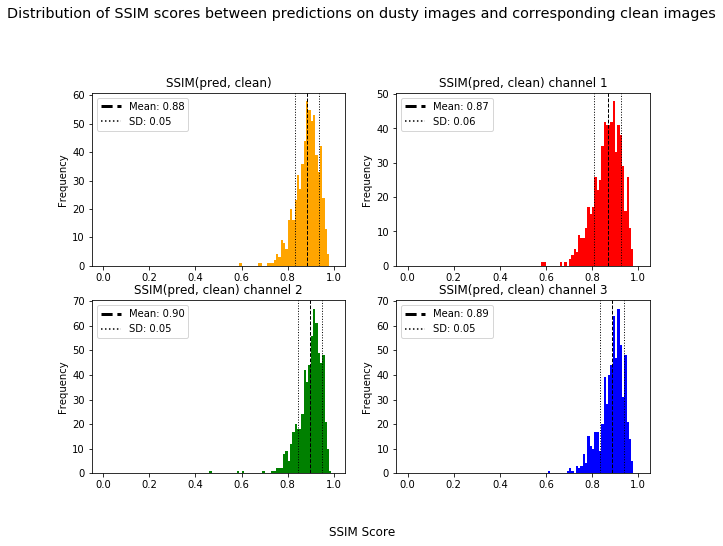

In [ ]:
plot_ssim(ssim_dusty_clean, 2, 2, 'Distribution of SSIM scores between predictions on dusty images and corresponding clean images', 'SSIM Score', 'Frequency', ['orange', 'red', 'green', 'blue'], (10,7))

In [ ]:
ssim_dusty_clean = ssim_dusty_clean.join(ssim_data['SSIM(dusty, clean)'])
ssim_dusty_clean

,"SSIM(pred, clean)","SSIM(pred, clean) channel 1","SSIM(pred, clean) channel 2","SSIM(pred, clean) channel 3","SSIM(dusty, clean)"
0,0.843694,0.840864,0.864691,0.825527,0.594658
1,0.918392,0.918435,0.923096,0.913646,0.782398
2,0.848799,0.786832,0.874553,0.885012,0.637052
3,0.818007,0.790324,0.844492,0.819206,0.368799
4,0.875318,0.866982,0.885837,0.873134,0.805644
...,...,...,...,...,...
619,0.890724,0.859476,0.896947,0.915748,0.586413
620,0.851719,0.857859,0.855454,0.841846,0.676432
621,0.841528,0.823367,0.844696,0.856520,0.687071
622,0.828318,0.773677,0.861158,0.850119,0.744172


In [ ]:
ssim_dusty_clean['Δ(SSIM(pred, clean), SSIM(dusty, clean))'] = ssim_dusty_clean['SSIM(pred, clean)'] - ssim_dusty_clean['SSIM(dusty, clean)']
ssim_dusty_clean

,"SSIM(pred, clean)","SSIM(pred, clean) channel 1","SSIM(pred, clean) channel 2","SSIM(pred, clean) channel 3","SSIM(dusty, clean)","Δ(SSIM(pred, clean), SSIM(dusty, clean))"
0,0.843694,0.840864,0.864691,0.825527,0.594658,0.249036
1,0.918392,0.918435,0.923096,0.913646,0.782398,0.135994
2,0.848799,0.786832,0.874553,0.885012,0.637052,0.211747
3,0.818007,0.790324,0.844492,0.819206,0.368799,0.449208
4,0.875318,0.866982,0.885837,0.873134,0.805644,0.069674
...,...,...,...,...,...,...
619,0.890724,0.859476,0.896947,0.915748,0.586413,0.304310
620,0.851719,0.857859,0.855454,0.841846,0.676432,0.175288
621,0.841528,0.823367,0.844696,0.856520,0.687071,0.154456
622,0.828318,0.773677,0.861158,0.850119,0.744172,0.084145


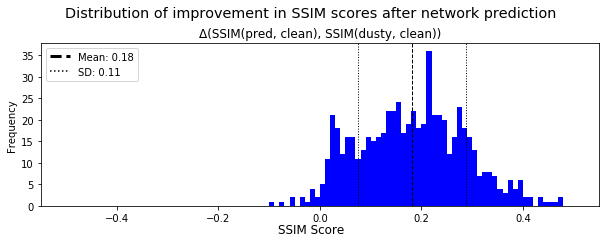

In [ ]:
plot_delta(ssim_dusty_clean[['Δ(SSIM(pred, clean), SSIM(dusty, clean))']], 1, 1, 'Distribution of improvement in SSIM scores after network prediction', 'SSIM Score', 'Frequency', ['blue'], figsize=(10,3))



*   Get top 3 items with biggest improvement - i.e. biggest delta.
*   Get top 3 items with smallest improvement.



In [ ]:
ssim_dusty_clean.nlargest(3, columns=['Δ(SSIM(pred, clean), SSIM(dusty, clean))'])

,"SSIM(pred, clean)","SSIM(pred, clean) channel 1","SSIM(pred, clean) channel 2","SSIM(pred, clean) channel 3","SSIM(dusty, clean)","Δ(SSIM(pred, clean), SSIM(dusty, clean))"
145,0.681546,0.594039,0.690253,0.760347,0.092581,0.588966
215,0.805549,0.792979,0.808669,0.814999,0.328589,0.476960
331,0.777959,0.724012,0.828226,0.781638,0.305511,0.472447


In [ ]:
indexes = ssim_dusty_clean.nlargest(3, columns=['Δ(SSIM(pred, clean), SSIM(dusty, clean))']).index.to_list()

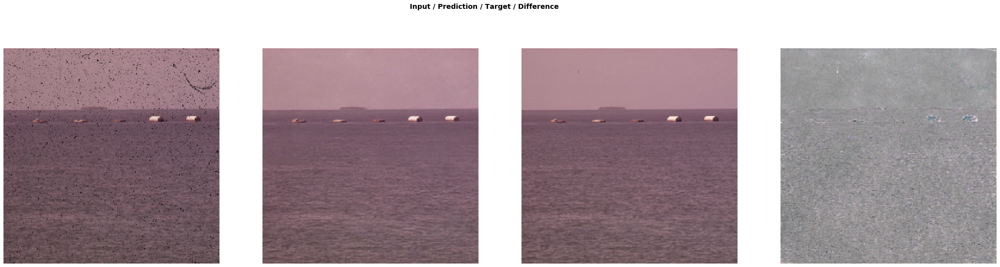

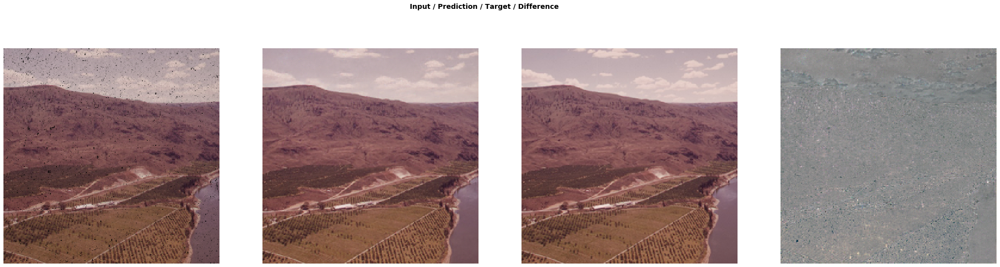

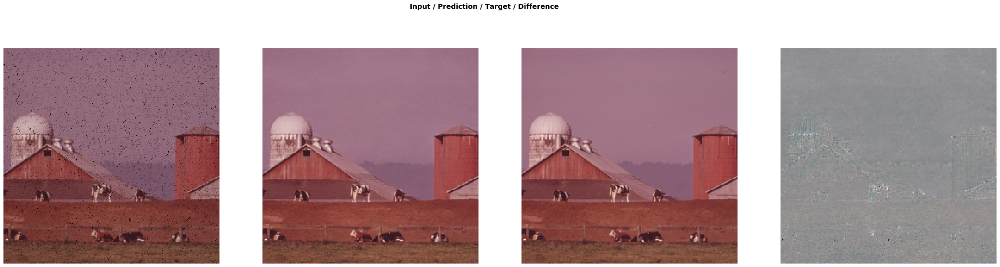

In [ ]:
generator_test.show_results = _show_results_eval(generator_test, indexes=indexes, imgsize=9)

In [ ]:
ssim_dusty_clean.nsmallest(3, columns=['Δ(SSIM(pred, clean), SSIM(dusty, clean))'])

,"SSIM(pred, clean)","SSIM(pred, clean) channel 1","SSIM(pred, clean) channel 2","SSIM(pred, clean) channel 3","SSIM(dusty, clean)","Δ(SSIM(pred, clean), SSIM(dusty, clean))"
167,0.756408,0.735764,0.784293,0.749168,0.848952,-0.092544
193,0.858526,0.774864,0.865134,0.935579,0.937307,-0.078781
508,0.890211,0.858393,0.902761,0.909478,0.949245,-0.059035


In [ ]:
indexes = ssim_dusty_clean.nsmallest(3, columns=['Δ(SSIM(pred, clean), SSIM(dusty, clean))']).index.to_list()
indexes

[167, 193, 508]

Look at the prediction for these items.

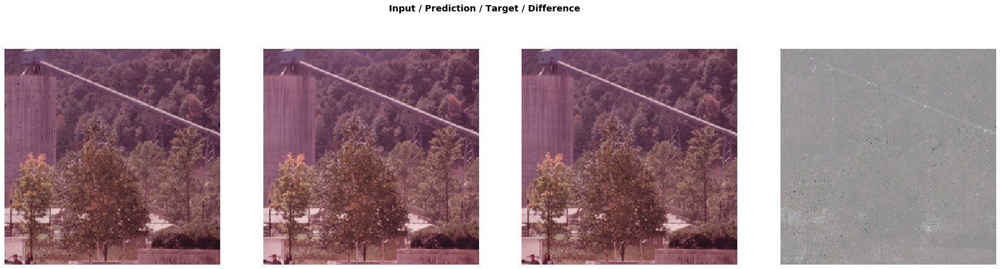

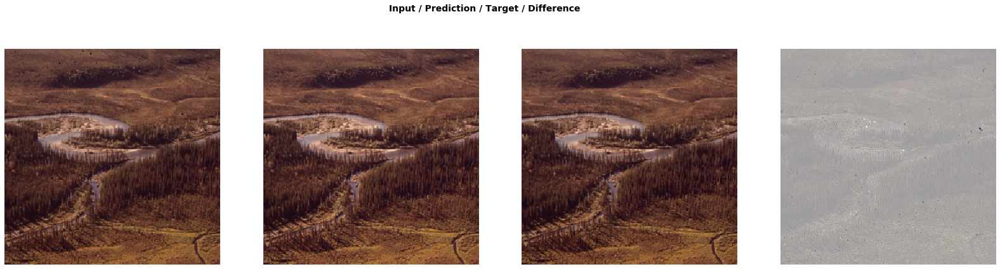

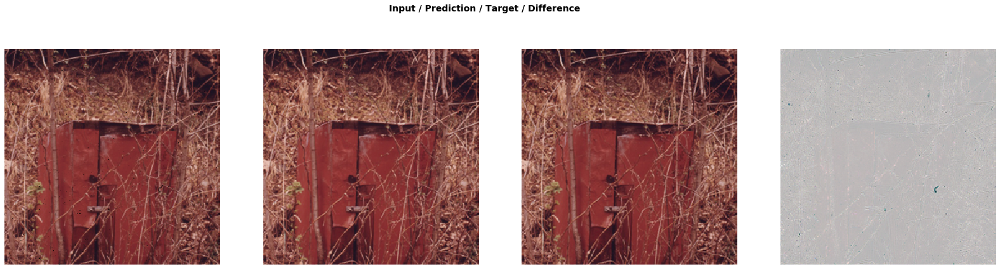

In [ ]:
generator_test.show_results = _show_results_eval(generator_test, indexes=indexes, imgsize=7)

Now check wat happens to already clean images.

In [ ]:
generator_test = unet_learner(data_gen_test_clean, arch, wd=wd, blur=True, norm_type=NormType.Weight,
                         self_attention=True, y_range=y_range, loss_func=loss_gen, path=path).load('gen-pre-256-unfrozen-'+experiment_id).to_fp16()

In [ ]:
ssim_clean_clean = validate_ssim(generator_test, SSIM_metric_eval(per_channel=True), data_gen_test_clean)

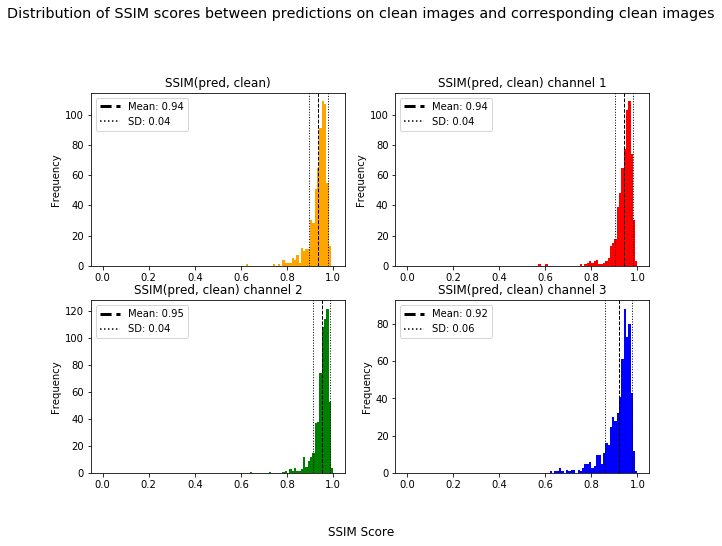

In [ ]:
plot_ssim(ssim_clean_clean, 2, 2, 'Distribution of SSIM scores between predictions on clean images and corresponding clean images', 'SSIM Score', 'Frequency', ['orange', 'red', 'green', 'blue'], (10,7))

In [ ]:
ssim_clean_clean

,"SSIM(pred, clean)","SSIM(pred, clean) channel 1","SSIM(pred, clean) channel 2","SSIM(pred, clean) channel 3"
0,0.930880,0.945508,0.953279,0.893851
1,0.917786,0.888476,0.946199,0.918683
2,0.965840,0.964252,0.972166,0.961101
3,0.961834,0.945545,0.972147,0.967812
4,0.937159,0.940054,0.945608,0.925816
...,...,...,...,...
619,0.962145,0.959150,0.968839,0.958445
620,0.838047,0.893260,0.892630,0.728253
621,0.966340,0.956488,0.985147,0.957385
622,0.851391,0.866299,0.894372,0.793503


These clean images were damaged the most.

In [ ]:
ssim_clean_clean.nsmallest(3, columns=['SSIM(pred, clean)'])

,"SSIM(pred, clean)","SSIM(pred, clean) channel 1","SSIM(pred, clean) channel 2","SSIM(pred, clean) channel 3"
59,0.624818,0.608091,0.645189,0.621173
559,0.744275,0.806878,0.726344,0.699603
321,0.767660,0.826321,0.819638,0.657022


In [ ]:
indexes = ssim_clean_clean.nsmallest(3, columns=['SSIM(pred, clean)']).index.to_list()

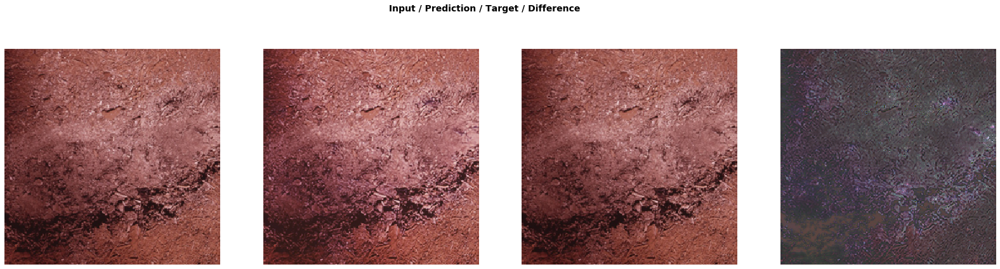

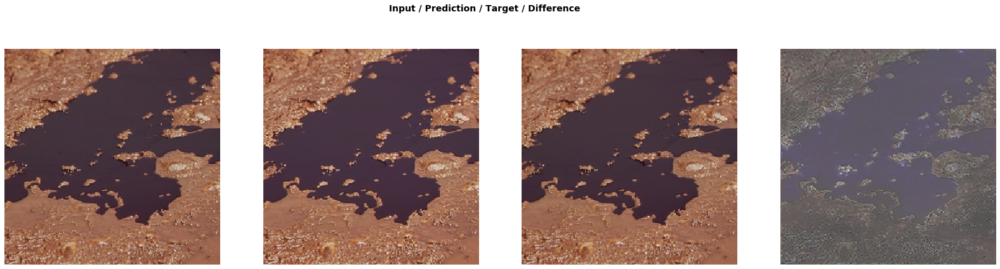

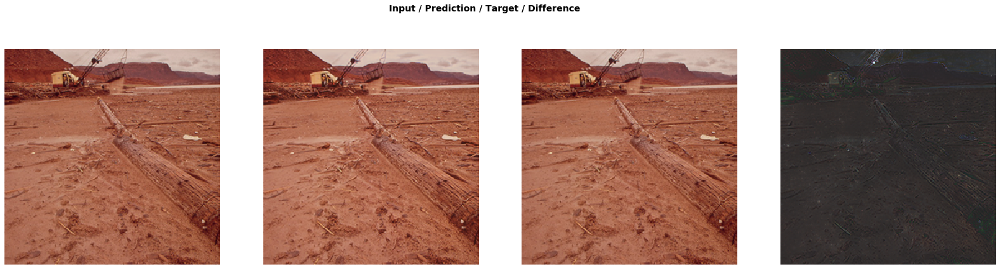

In [ ]:
generator_test.show_results = _show_results_eval(generator_test, indexes=indexes, imgsize=7)

And these were damaged the least.

In [ ]:
ssim_clean_clean.nlargest(3, columns=['SSIM(pred, clean)'])

,"SSIM(pred, clean)","SSIM(pred, clean) channel 1","SSIM(pred, clean) channel 2","SSIM(pred, clean) channel 3"
524,0.993728,0.995139,0.994692,0.991353
248,0.993010,0.993134,0.994570,0.991328
571,0.993004,0.990485,0.995443,0.993082


In [ ]:
indexes = ssim_clean_clean.nlargest(3, columns=['SSIM(pred, clean)']).index.to_list()

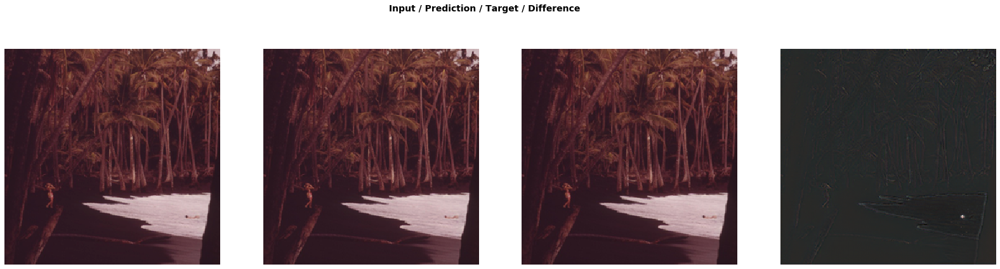

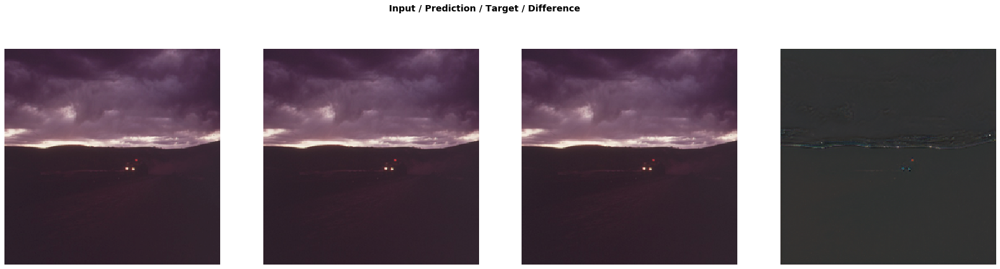

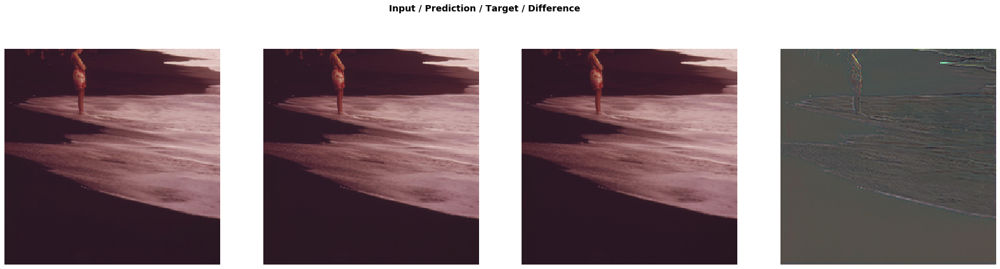

In [ ]:
generator_test.show_results = _show_results_eval(generator_test, indexes=indexes, imgsize=7)